# Восстановление золота из руды

<h1>Содержание<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Описание-проекта" data-toc-modified-id="Описание-проекта-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Описание проекта</a></span></li><li><span><a href="#Анализ-общей-информации" data-toc-modified-id="Анализ-общей-информации-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Анализ общей информации</a></span></li><li><span><a href="#Предобработка-данных" data-toc-modified-id="Предобработка-данных-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Предобработка данных</a></span></li><li><span><a href="#Разбиение-данных-на-выборки-и-моделирование" data-toc-modified-id="Разбиение-данных-на-выборки-и-моделирование-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Разбиение данных на выборки и моделирование</a></span></li><li><span><a href="#Общий-вывод" data-toc-modified-id="Общий-вывод-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Общий вывод</a></span></li></ul></div>

### Описание проекта

**Заказчик**: компания ООО "Цифра".

**Данные**: данные процесса восстановления золота из золотосодержащей руды промышленного предприятия. Предоставлены данные с параметрами добычи и очистки.

**Бизнес-цель**: оптимизировать производство, чтобы не запускать предприятие с убыточными характеристиками.

**Задача**: предсказать коэффициент восстановления золота из золотосодержащей руды.

**Метрика**: \begin{align}
{sMAPE} = \frac{1}{N} \sum_{i=1}^{N}\frac{|y_i-\hat{y_i}|}{(|y_i|+|\hat{y_i}|)/2}\times100\%
\end{align}

Нужно спрогнозировать сразу две величины:
* эффективность обогащения чернового концентрата rougher.output.recovery;
* эффективность обогащения финального концентрата final.output.recovery.

Итоговая метрика складывается из двух величин:

\begin{align}
{Итоговое sMAPE} = 25\% \times sMAPE(rougher) + 75\% \times sMAPE(final)
\end{align}

### Анализ общей информации

#### Загрузка библиотек, чтение данных и анализ общей информации</a>

In [1]:
# Для анализа данных будем использовать библиотеку pandas_profiling.
# Установим библиотеку и изменим версию pandas c которой profiling работает стабильно
!pip install pandas_profiling==1.4.1 -q
!pip install pandas==0.25.3 -q
!pip install missingno -q
!pip install pingouin -q

In [2]:
# Импортируем библиотеки, с помощью которых будем обрабатывать данные
import pandas_profiling # для анализа статистик и распределений данных
import pandas as pd # для работы с табличными данными
import numpy as np
import time
from scipy import stats # для работы со статистиками
from pingouin import ttest
from scipy.stats import norm # для отображения нормального распределения на графиках гистограмм


# для визуализации данных
import plotly
import plotly.express as px
import matplotlib.pyplot as plt 
import seaborn as sns
import missingno as msno # для визуализации пропусков в данных
%matplotlib inline

from sklearn.utils import shuffle
from sklearn.metrics import make_scorer, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV

from catboost import CatBoostRegressor

# Установка настроек для отображения всех колонок и строк при печати
pd.set_option('display.max_columns', None)

# Настройки для печати нескольких выводов данных в одной ячейке
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

# Игнорирование предупреждения об ошибках
import warnings
warnings.filterwarnings('ignore')

SEED = 42

stages_concentrate = {
    'rougher.input.feed' : "Флотация (сырье)", 
    'rougher.output.concentrate' : "Флотация ", 
    'primary_cleaner.output.concentrate' : "Первичная очистка", 
    'final.output.concentrate' : "Финальные характеристики"
}

metals = {
    'au' : 'Золото',
    'ag' : 'Cеребро', 
    'pb' : 'Свинец' 
}

stage_colors = {
    'Флотация (сырье)' :  '#7CCD7C',
    'Флотация' :  '#7DC5C1',
    'Первичная очистка' : '#84B6EA',
    'Финальные характеристики' : '#AF149A'
}

C:\Users\Magicbuka\Anaconda3\lib\site-packages\outdated\utils.py:18: OutdatedPackageWarning: The package pingouin is out of date. Your version is 0.3.11, the latest is 0.4.0.
Set the environment variable OUTDATED_IGNORE=1 to disable these warnings.
  **kwargs


In [3]:
# Блок самописных функций

# Расчет метрики
def smape(y_true, y_pred):
    return 100 * (2 * abs(y_true - y_pred) / (abs(y_true) + abs(y_pred))).sum() / len(y_true)

# Расчет финальной метрики
def final_smape(smape_rougher, smape_cleaner):
    return (0.25 * smape_rougher) + (0.75 * smape_cleaner)

# Проверка гипотез
def hypothesis_testing(subdf_1, subdf_2, title):
    
    # Построим гистрограммы распределений размеров гранул сырья 
    # для обучающей и тестовой выборок
    # с наложением фактического распределения и нормального 
    fig = plt.figure(figsize=(15,10)) 
    ax1 = sns.distplot(subdf_1, label='Обучающая выборка', bins=60) 
    ax2 = sns.distplot(subdf_2, label='Тестовая выборка', bins=60) 
    ax3 = plt.legend() 
    ax4 = plt.title('Гистрограммы распределений размеров гранул сырья ' + 'перед этапом ' + title)
    ax5 = plt.xlabel('Размер гранул сырья')
    plt.show();
        
    # Посчитаем дисперсию выборок. 
    # Т.к. мы работаем с выборочной дисперсией, будем использовать параметр `ddof=1`
    print("Дисперсия обучающей выборки:", subdf_1.var(ddof=1))
    print("Дисперсия тестовой выборки:", subdf_2.var(ddof=1))
    print('')
    # Посмотрим на средние показатели выборок
    print("Среднее обучающей выборки:", subdf_1.mean())
    print("Среднее тестовой выборки:", subdf_2.mean())
    print('')
    
    # Проверим гипотезу, что средние обучающей и тестовых выборок одинаковы
    # уровень статистической значимости установим в значении 0.05 (порог 5% считается общепринятиым)
    # если p-value окажется меньше него - отвергнем нулевую гипотезу

    results = ttest(subdf_1, subdf_2, paired=False, tail='two-sided')

    alpha = .05 

    print('p-значение:', results['p-val'][0])

    if results['p-val'][0] < alpha:
        print("Отвергаем нулевую гипотезу")
    else:
        print("Не получилось отвергнуть нулевую гипотезу") 
        
def get_metal_concentrate(df):
    metal_concentrate = {}

    for metal in metals:
        metal_concentrate[metal] = df_train[[stage + '_' + metal for stage in stages_concentrate]]   
        
    return metal_concentrate

def show_metal_hist(df_stacked, title, x_title):
    df_stacked.columns = ['date', 'stage', 'concentrate']

    fig = px.histogram(
            df_stacked, 
            x = 'concentrate', 
            marginal = 'box', 
            color = "stage",
            color_discrete_map=stage_colors,
            opacity = 0.7,
            title = title
    )

    fig.update_layout(barmode='overlay')
    fig.update_layout(xaxis_title=x_title, yaxis_title='Частота')
    fig.show()
    
def show_metal_concentrate(metal_concentrate):
    for metal in metals:
        df_metal = metal_concentrate[metal]

        df_metal.columns = stages_concentrate.values()
        
        show_metal_hist(
            df_metal.stack().reset_index(), 
            'Распределение по этапам концентрации металла: {0}'.format(metals[metal]),
            metals[metal]
        )

# Напишем функцию для возможности запуска нескольких дефолтных моделей с перекрестной проверкой
def Model(features_train, target_train, model_info):
     
    lst_smape = cross_val_score(model_info[0], features_train, target_train, cv=5, scoring=make_scorer(smape))
    
    smape_result = sum(lst_smape) / len(lst_smape)     
        
    lst_results = [model_info[1], smape_result]
        
    return lst_results

# Напишем функцию start_model для запуска функции Model в цикле 
def start_model(features_train, target_train, model_list, title):
    print(title)
    table_models = []
    for model_info in model_list:
        start_time = time.time()
        lst_model = Model(features_train, target_train, model_info)
        time_model = round((time.time() - start_time),2)
        lst_model.append(time_model)
        table_models.append(lst_model)
        
    df_m = pd.DataFrame(data=table_models, columns=['model', 'smape', 'time_model'])
    table = df_m.pivot_table(values=['smape', 'time_model'],    
                             index=['model'])
    best_score = df_m['smape'].min()

    print(table)
    print('---------------------------------')
    return best_score
        
def grid_search(X_train, y_train, X_test, y_test, title):
    print(title)
    # задаем сетку гиперпараметров
    param_grid = {'alpha': np.logspace(-3, 1, 10),
                  'solver': ['auto', 'svd', 'cholesky', 'lsqr', 'sparse_cg', 'sag', 'saga'], 
                  'tol': [0.001, 0.01, 0.1]}

    # создаем экземпляр класса GridSearchCV
    grid_search = GridSearchCV(Ridge(random_state=12345), 
                               param_grid, 
                               scoring=make_scorer(smape, greater_is_better=False),
                               n_jobs=-1, 
                               cv=5)    
    
    # запускаем решетчатый поиск
    gs = grid_search.fit(np.array(X_train), np.array(y_train))
    smape_test = smape(y_test, gs.best_estimator_.predict(X_test))
    print('sMAPE модели с наилучшими значениями гиперпараметров на тестовой выборке: {:.2f}'.format(smape_test))
    print('----------------------------------------')
    return smape_test         

In [4]:
# Считываем данные
l = locals()
df_dict = {}
for df_name, set_name in {'df_train': 'gold_recovery_train', 
                       'df_test': 'gold_recovery_test', 
                       'df_full': 'gold_recovery_full'}.items():
    try: 
        l[df_name] = pd.read_csv(f'datasets\\{set_name}.csv')
    except:
        print(f'Файл {set_name}.csv не найден и будет скачиваться по сети.')
        l[df_name] = pd.read_csv(f'https://code.s3.yandex.net/datasets/{set_name}.csv') 
    df_dict[set_name] = l[df_name]

Файл gold_recovery_train.csv не найден и будет скачиваться по сети.
Файл gold_recovery_test.csv не найден и будет скачиваться по сети.
Файл gold_recovery_full.csv не найден и будет скачиваться по сети.


In [5]:
# Запусим библиотеку pandas_profiling и посмотрим как выглядят статистики 
for key, value in df_dict.items():
    print('Анализ набора данных ' + key)
    pandas_profiling.ProfileReport(value)

<a
href="https://nbviewer.jupyter.org/github/magicbuka/ds_projects/blob/main/predicting_the_recovery_rate_of_gold/report_df_train.ipynb">Анализ набора данных gold_recovery_train</a>  
<a
href="https://nbviewer.jupyter.org/github/magicbuka/ds_projects/blob/main/predicting_the_recovery_rate_of_gold/report_df_test.ipynb">Анализ набора данных gold_recovery_test</a>  
<a
href="https://nbviewer.jupyter.org/github/magicbuka/ds_projects/blob/main/predicting_the_recovery_rate_of_gold/report_df_full.ipynb">Анализ набора данных gold_recovery_full</a>

Инструмент pandas_profiling позволяет изучить основную информацию о значениях и статистиках по признакам. Автоматический анализатор позволяет быстро получить информацию о типах данных, распределениях, наличиях пропусков и дублей в наборе данных. Так же можно увидеть информацию о корреляции между признаками или признаками и целевой переменной. Данный инструмент не позволяет ответить на все вопросы о наших данных, но помогает довольно быстро оценить основные проблемы, присутствующие в данных и определиться с инструментами для более детального анализа.

Анализ набора данных gold_recovery_train
Анализ набора данных gold_recovery_test
Анализ набора данных gold_recovery_full


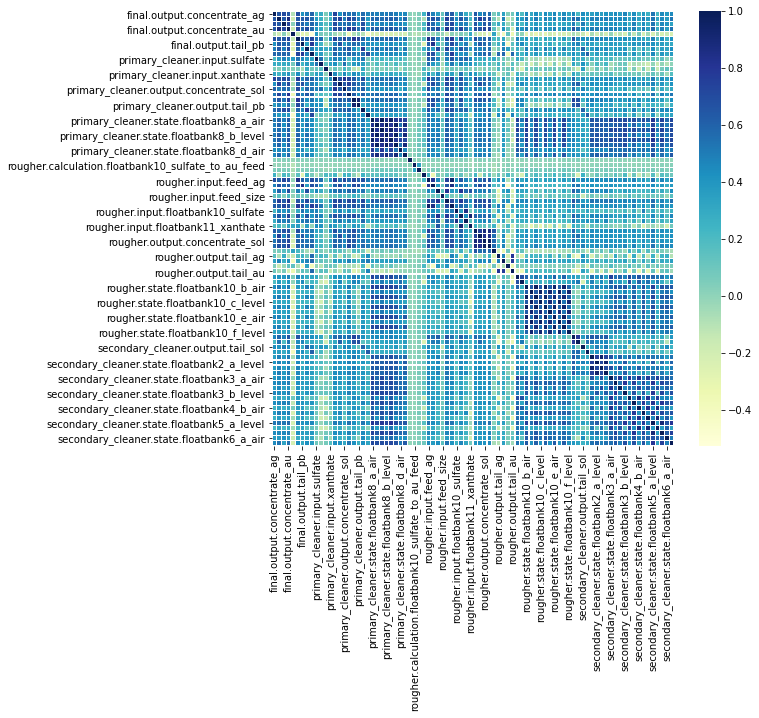

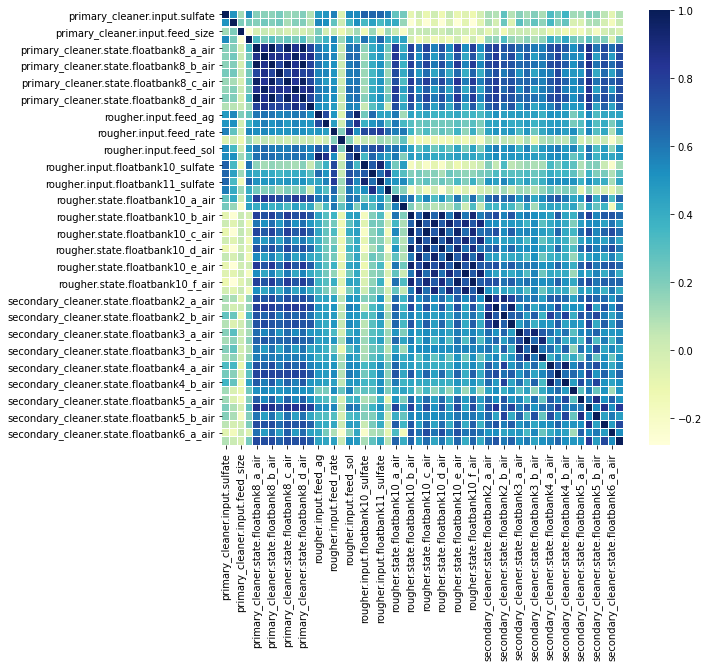

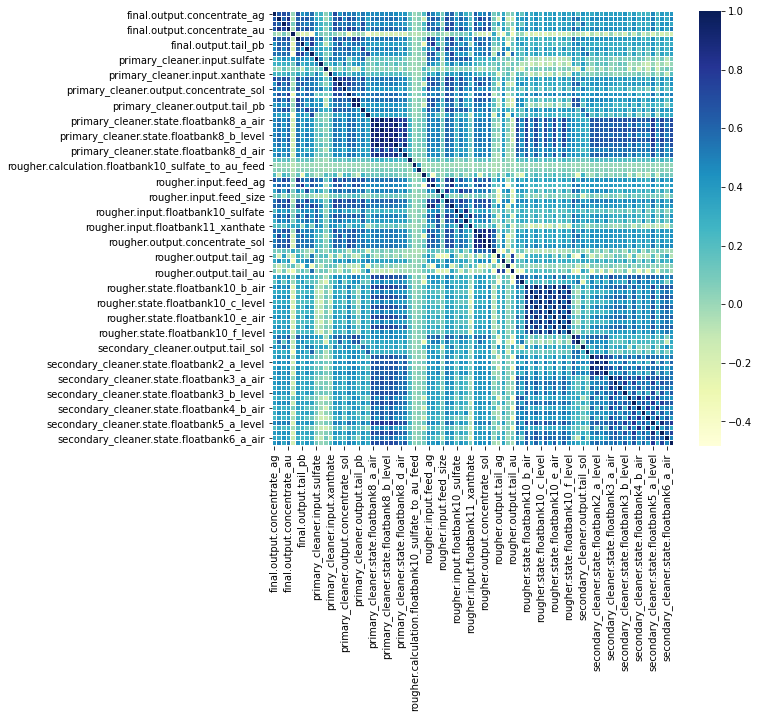

In [6]:
# Т.к. в pandas_profiling корреляционная матрица отобразилась не очень корректно,
# выведем её отдельно для каждого набора данных
for key, value in df_dict.items():
    print('Анализ набора данных ' + key)
    corrmat = value.corr();
    f, ax = plt.subplots(figsize =(9, 8));
    d = sns.heatmap(corrmat, ax = ax, cmap ="YlGnBu", linewidths = 0.1);

Анализ набора данных gold_recovery_train
Анализ набора данных gold_recovery_test
Анализ набора данных gold_recovery_full


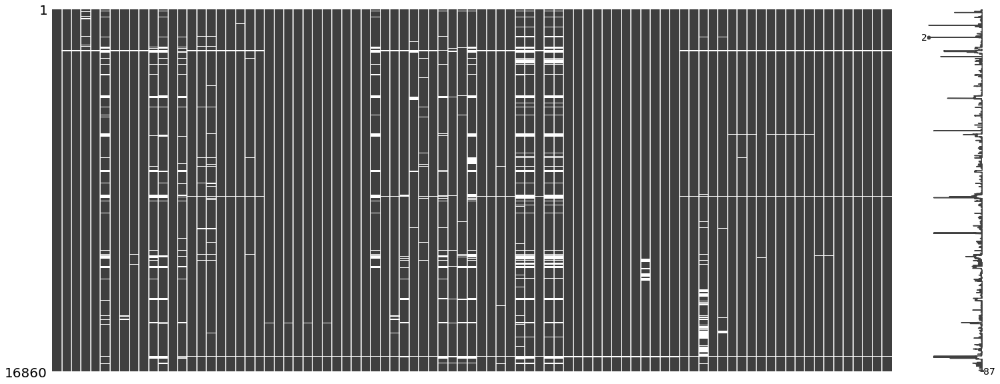

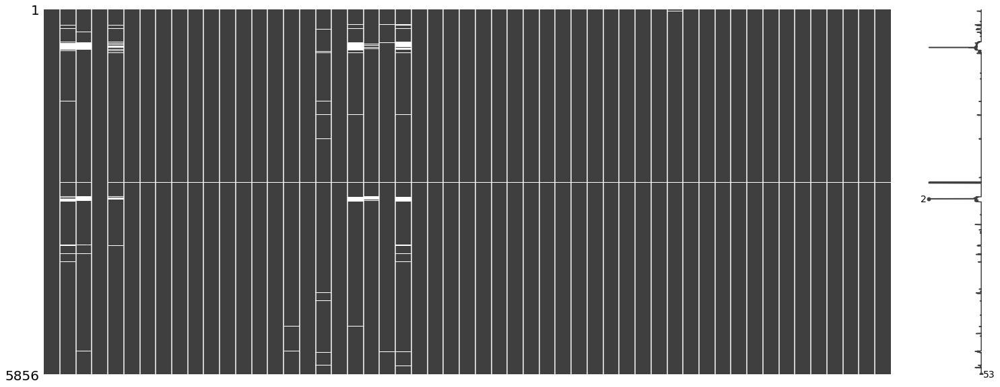

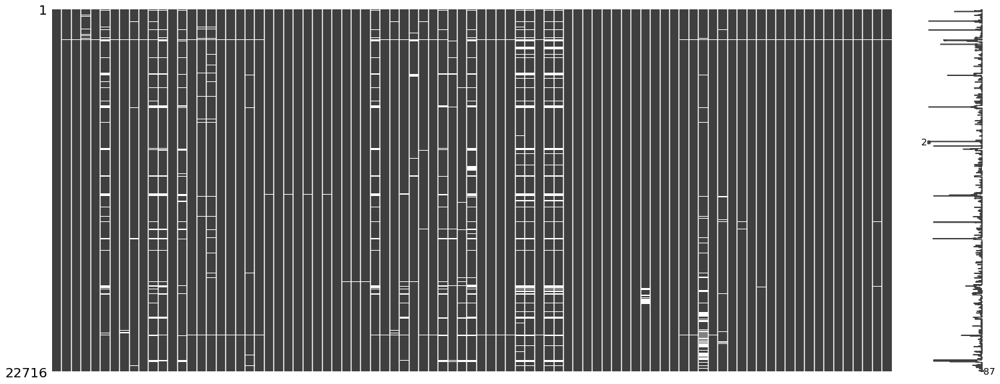

In [7]:
# Визуализируем количество пропусков в данных
# Используем в цикле метод msno.matrix для определения типов данных признаков и описательных статистик по всем датасетам
for key, value in df_dict.items():
    print('Анализ набора данных ' + key)
    a = msno.matrix(value);

**Вывод**

Заполнить пропуски средним между двумя соседними значениями.  
После завершения анализа сделать нормализацию данных

#### Анализ признаков, недоступных в тестовой выборке.

In [8]:
# Создадим переменную и поместим в неё список с названиями колонок
columns_out = list(set(df_full.columns)-set(df_test.columns))  
sorted(columns_out)

['final.output.concentrate_ag',
 'final.output.concentrate_au',
 'final.output.concentrate_pb',
 'final.output.concentrate_sol',
 'final.output.recovery',
 'final.output.tail_ag',
 'final.output.tail_au',
 'final.output.tail_pb',
 'final.output.tail_sol',
 'primary_cleaner.output.concentrate_ag',
 'primary_cleaner.output.concentrate_au',
 'primary_cleaner.output.concentrate_pb',
 'primary_cleaner.output.concentrate_sol',
 'primary_cleaner.output.tail_ag',
 'primary_cleaner.output.tail_au',
 'primary_cleaner.output.tail_pb',
 'primary_cleaner.output.tail_sol',
 'rougher.calculation.au_pb_ratio',
 'rougher.calculation.floatbank10_sulfate_to_au_feed',
 'rougher.calculation.floatbank11_sulfate_to_au_feed',
 'rougher.calculation.sulfate_to_au_concentrate',
 'rougher.output.concentrate_ag',
 'rougher.output.concentrate_au',
 'rougher.output.concentrate_pb',
 'rougher.output.concentrate_sol',
 'rougher.output.recovery',
 'rougher.output.tail_ag',
 'rougher.output.tail_au',
 'rougher.output.ta

**Вывод**

Отсутствуют выходные (output) и некоторые расчетные (calculation) характеристики процесса. Данные признаки недоступны, так как их невозможно получить/измерить во время выполнения технологического процесса.

#### Исследуем суммарную концентрацию всех веществ на разных стадиях: в сырье, в черновом и финальном концентратах.

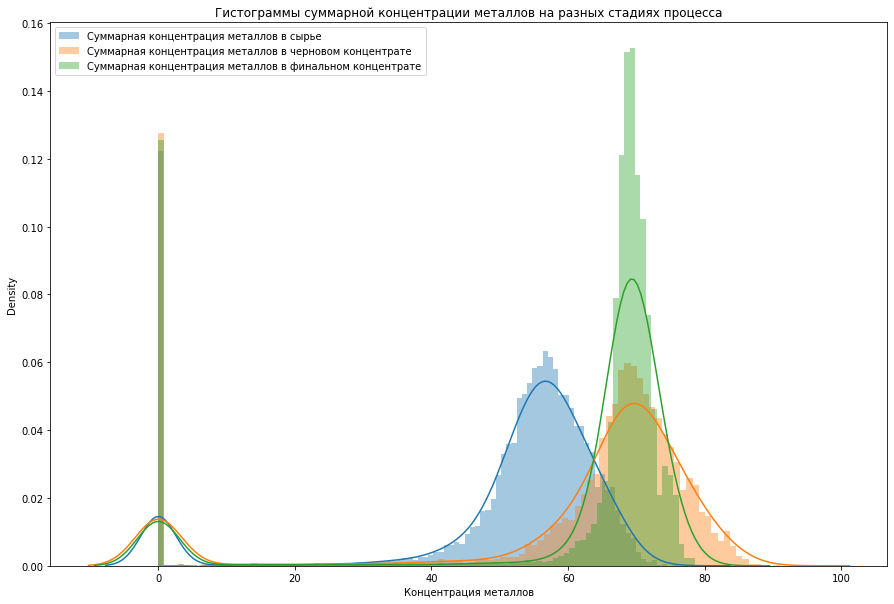

In [9]:
# Посчитаем суммарную концентрацию веществ для разных этапов
df_train['sum.rougher.input.feed'] = df_train['rougher.input.feed_pb'] + df_train['rougher.input.feed_ag'] + df_train['rougher.input.feed_sol'] + df_train['rougher.input.feed_au']
df_train['sum.rougher.output.concetrate'] = df_train['rougher.output.concentrate_pb'] + df_train['rougher.output.concentrate_ag'] + df_train['rougher.output.concentrate_sol'] + df_train['rougher.output.concentrate_au']
df_train['sum.final.output.concetrate'] = df_train['final.output.concentrate_pb'] + df_train['final.output.concentrate_ag']+ df_train['final.output.concentrate_sol'] + df_train['final.output.concentrate_au']

# Построим гистрограммы суммарной концентраци металлов на разных стадиях процесса
fig = plt.figure(figsize=(15,10))
lst1 = df_train['sum.rougher.input.feed']
lst2 = df_train['sum.rougher.output.concetrate']
lst3 = df_train['sum.final.output.concetrate']
ax1 = sns.distplot(lst1, label='Суммарная концентрация металлов в сырье', bins = 100)
ax2 = sns.distplot(lst2, label='Суммарная концентрация металлов в черновом концентрате', bins = 100)
ax3 = sns.distplot(lst3, label='Суммарная концентрация металлов в финальном концентрате', bins = 100)
ax4 = plt.legend()
ax5 = plt.title('Гистограммы суммарной концентрации металлов на разных стадиях процесса')
ax6 = plt.xlabel('Концентрация металлов')
plt.show()   

На графике видны аномальные околонулевые значения суммарных концентраций.

In [10]:
# Посмотрим на данные для выявления аномальных значений
df_train[(df_train['sum.rougher.input.feed'] == 0) |\
        (df_train['sum.rougher.output.concetrate'] == 0) |\
        (df_train['sum.final.output.concetrate'] == 0)][['date', 'rougher.input.feed_au',
                                                                'rougher.input.feed_ag',
                                                                'rougher.input.feed_pb',
                                                                'rougher.input.feed_sol',
                                                                'rougher.output.concentrate_au',
                                                                'rougher.output.concentrate_ag',
                                                                'rougher.output.concentrate_pb',
                                                                'rougher.output.concentrate_sol',
                                                                'rougher.output.tail_au',
                                                                'rougher.output.tail_ag',
                                                                'rougher.output.tail_pb',
                                                                'rougher.output.tail_sol',
                                                                'sum.rougher.input.feed',
                                                                'sum.final.output.concetrate',
                                                                'sum.rougher.output.concetrate']].head()

,date,rougher.input.feed_au,rougher.input.feed_ag,rougher.input.feed_pb,rougher.input.feed_sol,rougher.output.concentrate_au,rougher.output.concentrate_ag,rougher.output.concentrate_pb,rougher.output.concentrate_sol,rougher.output.tail_au,rougher.output.tail_ag,rougher.output.tail_pb,rougher.output.tail_sol,sum.rougher.input.feed,sum.final.output.concetrate,sum.rougher.output.concetrate
45,2016-01-16 21:00:00,7.114065,7.521974,2.811569,41.154430,0.0,0.0,0.0,0.0,1.939811,4.784398,0.818965,20.046797,58.602038,66.175996,0.0
46,2016-01-16 22:00:00,7.651522,7.313187,2.973841,41.983063,0.0,0.0,0.0,0.0,2.087628,4.955785,0.891051,19.633741,59.921613,66.794250,0.0
47,2016-01-16 23:00:00,5.587750,7.934791,1.763437,NaN,0.0,0.0,0.0,0.0,2.126460,4.990718,0.901107,19.096033,NaN,67.572604,0.0
48,2016-01-17 00:00:00,4.752992,7.756881,1.025762,11.816724,0.0,0.0,0.0,0.0,1.938869,4.711415,0.636352,12.720009,25.352358,NaN,0.0
49,2016-01-17 01:00:00,0.033369,0.047333,0.008001,0.115461,0.0,0.0,0.0,0.0,2.043403,4.974262,0.568174,10.889648,0.204164,NaN,0.0


In [11]:
# Посмотрим на данные для выявления аномальных значений
df_train[df_train['rougher.input.feed_au'] < df_train['rougher.output.tail_au']][['date', 'rougher.input.feed_au',
                                                                'rougher.input.feed_ag',
                                                                'rougher.input.feed_pb',
                                                                'rougher.input.feed_sol',
                                                                'rougher.output.concentrate_au',
                                                                'rougher.output.concentrate_ag',
                                                                'rougher.output.concentrate_pb',
                                                                'rougher.output.concentrate_sol',
                                                                'rougher.output.tail_au',
                                                                'rougher.output.tail_ag',
                                                                'rougher.output.tail_pb',
                                                                'rougher.output.tail_sol',
                                                                'sum.rougher.input.feed',
                                                                'sum.final.output.concetrate',
                                                                'sum.rougher.output.concetrate']].head()

,date,rougher.input.feed_au,rougher.input.feed_ag,rougher.input.feed_pb,rougher.input.feed_sol,rougher.output.concentrate_au,rougher.output.concentrate_ag,rougher.output.concentrate_pb,rougher.output.concentrate_sol,rougher.output.tail_au,rougher.output.tail_ag,rougher.output.tail_pb,rougher.output.tail_sol,sum.rougher.input.feed,sum.final.output.concetrate,sum.rougher.output.concetrate
49,2016-01-17 01:00:00,0.033369,0.047333,0.008001,0.115461,0.000000,0.000000,0.000000,0.000000,2.043403,4.974262,0.568174,10.889648,0.204164,NaN,0.000000
372,2016-01-30 12:00:00,0.139652,0.143262,0.048073,0.582578,4.642559,3.036457,1.772630,7.032692,2.574309,6.326375,0.071850,20.529297,0.913565,6.857171,16.484337
377,2016-01-30 17:00:00,3.501578,5.386854,1.410441,4.688345,15.084039,17.494953,13.719635,22.922043,5.964024,8.409545,2.428082,11.907052,14.987218,NaN,69.220670
560,2016-02-07 08:00:00,1.921101,2.154076,0.700364,10.688802,19.619751,11.287204,7.728205,27.788122,1.939904,5.185513,0.702189,19.665477,15.464343,62.363101,66.423282
700,2016-02-13 04:00:00,0.253075,1.481370,NaN,NaN,1.483835,0.685755,0.579733,1.811070,1.477470,5.340394,0.398578,18.529297,NaN,NaN,4.560392


In [12]:
# Посмотрим на данные для выявления аномальных значений
df_train[df_train['rougher.input.feed_au'] > df_train['rougher.output.concentrate_au']][['date', 'rougher.input.feed_au',
                                                                'rougher.input.feed_ag',
                                                                'rougher.input.feed_pb',
                                                                'rougher.input.feed_sol',
                                                                'rougher.output.concentrate_au',
                                                                'rougher.output.concentrate_ag',
                                                                'rougher.output.concentrate_pb',
                                                                'rougher.output.concentrate_sol',
                                                                'rougher.output.tail_au',
                                                                'rougher.output.tail_ag',
                                                                'rougher.output.tail_pb',
                                                                'rougher.output.tail_sol',
                                                                'sum.rougher.input.feed',
                                                                'sum.final.output.concetrate',
                                                                'sum.rougher.output.concetrate']].head()

,date,rougher.input.feed_au,rougher.input.feed_ag,rougher.input.feed_pb,rougher.input.feed_sol,rougher.output.concentrate_au,rougher.output.concentrate_ag,rougher.output.concentrate_pb,rougher.output.concentrate_sol,rougher.output.tail_au,rougher.output.tail_ag,rougher.output.tail_pb,rougher.output.tail_sol,sum.rougher.input.feed,sum.final.output.concetrate,sum.rougher.output.concetrate
45,2016-01-16 21:00:00,7.114065,7.521974,2.811569,41.154430,0.0,0.0,0.0,0.0,1.939811,4.784398,0.818965,20.046797,58.602038,66.175996,0.0
46,2016-01-16 22:00:00,7.651522,7.313187,2.973841,41.983063,0.0,0.0,0.0,0.0,2.087628,4.955785,0.891051,19.633741,59.921613,66.794250,0.0
47,2016-01-16 23:00:00,5.587750,7.934791,1.763437,NaN,0.0,0.0,0.0,0.0,2.126460,4.990718,0.901107,19.096033,NaN,67.572604,0.0
48,2016-01-17 00:00:00,4.752992,7.756881,1.025762,11.816724,0.0,0.0,0.0,0.0,1.938869,4.711415,0.636352,12.720009,25.352358,NaN,0.0
49,2016-01-17 01:00:00,0.033369,0.047333,0.008001,0.115461,0.0,0.0,0.0,0.0,2.043403,4.974262,0.568174,10.889648,0.204164,NaN,0.0


**Вывод**

Выявленные особонности в данных:    
- Доля золота в сырье равна нулю.  
- Доля золота в хвостах после флотации выше чем доля золота в сырье.  
- Доля золота в концентрате после флотации равна нулю.  


Все данные аномалии свидетельствуют о некорректном отражении процесса и могут "испортить" модель. Поэтому требуется их удалить.

#### Сравним распределения размеров гранул сырья на обучающей и тестовой выборках.

Сформулируем гипотезы для проверки:   
    - H₀: средние значения размеров гранул сырья в обучающей и тестовой выборках одинаковы
    - H₁: средние значения размеров гранул сырья в обучающей и тестовой выборках различаются

Чтобы проверить гипотезу о равенстве среднего двух выборок, применим метод scipy.stats.ttest_ind - двухсторонний тест, поскольку нам не требуется сравнивать динамику среднего значения.

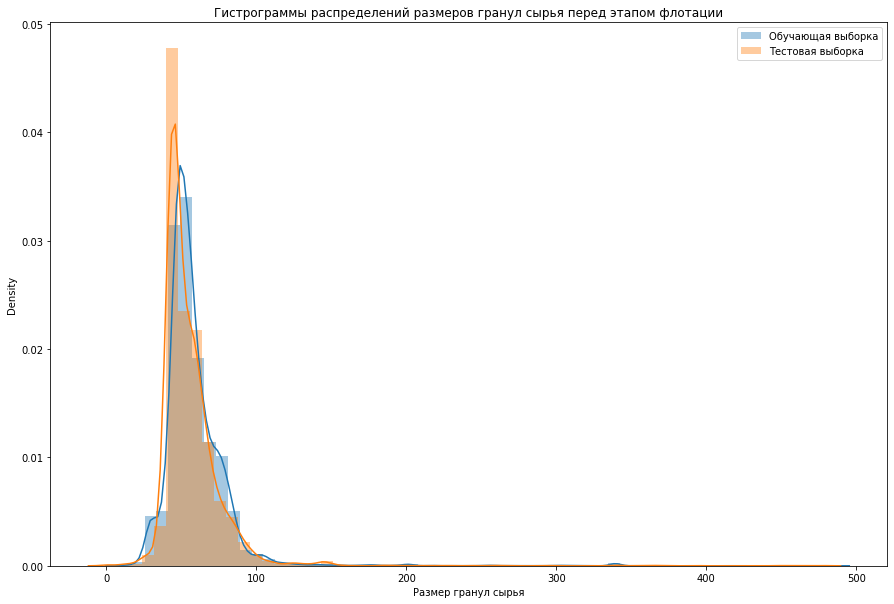

Дисперсия обучающей выборки: 572.2903491016468
Дисперсия тестовой выборки: 516.3917105196837

Среднее обучающей выборки: 58.67644376412437
Среднее тестовой выборки: 55.93753506406798

p-значение: 6.7950959991986745e-15
Отвергаем нулевую гипотезу


In [13]:
# Сформируем подвыборки для проверки распределений гранул перед этапом флотации
subdf_1 = df_train['rougher.input.feed_size']
subdf_2 = df_test['rougher.input.feed_size']
# Вызовем функцию
hypothesis_testing(subdf_1, subdf_2, "флотации")

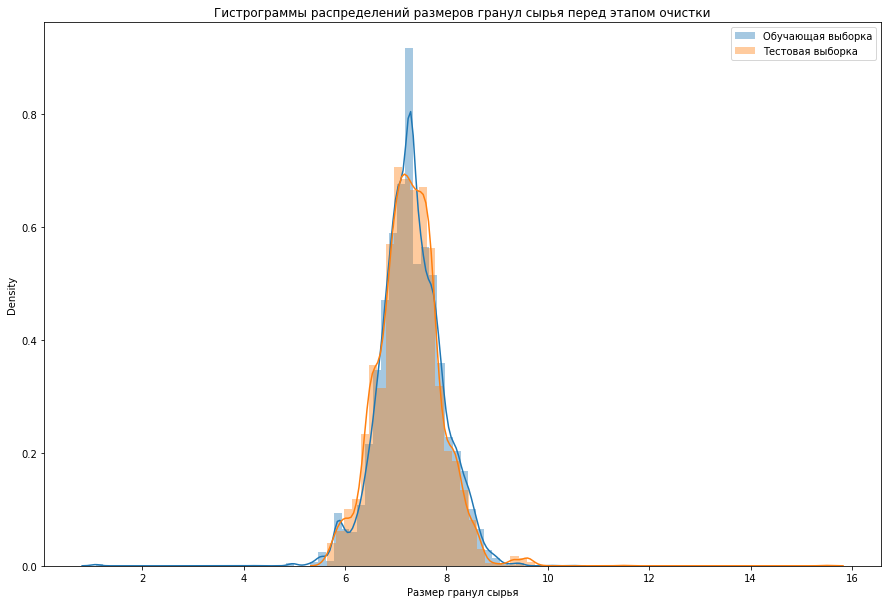

Дисперсия обучающей выборки: 0.383366239405203
Дисперсия тестовой выборки: 0.37396377933413605

Среднее обучающей выборки: 7.29728487125721
Среднее тестовой выборки: 7.264651292245429

p-значение: 0.0004554672200801049
Отвергаем нулевую гипотезу


In [14]:
# Сформируем подвыборки для проверки распределений гранул перед этапом очистки
subdf_3 = df_train['primary_cleaner.input.feed_size']
subdf_4 = df_test['primary_cleaner.input.feed_size']
# Вызовем функцию
hypothesis_testing(subdf_3, subdf_4, "очистки")

**Вывод**

Исходя из представленных данных, на уровне значимости 5% - есть основания отвергнуть обе нулевые гипотезы в пользу альтернативных. Использовать такое разделение на train/test нельзя, т.к. распределения сильно отличаются друг от друга и оценка модели будет неправильной.

#### Анализ изменения концентрации металлов (Au, Ag, Pb) на различных этапах.

Построим графики изменения концентрации металлов на различных этапах

In [15]:
metal_concentrate = get_metal_concentrate(df_train)

show_metal_concentrate(metal_concentrate)

**Вывод**

На графиках видно, что:

- на извлечении золота положительно сказываются все этапы процесса: концентрация золота в концентрате увеличивается, в хвостах - уменьшается;
- на извлечение серебра положительно оказывает этап флотации (увеличение концетрации в концентрате, уменьшение в хвостах) и замечено не очень хорошее влияние процессов очистки (заметно снижение концентрата в концентрате и увеличение содержания серебра в хвостах, по сравнению с этапом флотации, особенно после этапа первой очистки)
- на извлечение свинца положительно сказывается этап флотации (увеличение концетрации в концентрате, уменьшение в хвостах) и замечено незначительное увеличение концентрации в концентрате после этапов очистки, при этом хвосты по сравнению с этапом флотации - увелитились.

### Предобработка данных

#### Преобразование данных и замена пропусков

Удалим строки с пропусками в целевых переменных `rougher.output.recovery` и `final.output.recovery` 

In [16]:
# Проверим размер набора данных до удаления строк
print(df_train.shape)
df_train = df_train.dropna(subset=['rougher.output.recovery', 'final.output.recovery'])
# Проверим размер набора данных после удаления строк
print(df_train.shape)

(16860, 90)
(14149, 90)


Используем метод interpolate для замены пропусков - берестся среднее между двумя соседями от пропущенного

In [17]:
df_train.interpolate(inplace=True)
df_test.interpolate(inplace=True)

# Удалим строки для устранения выявленных аномалий в данных
df_train = df_train.drop(df_train[df_train['sum.rougher.input.feed'] == 0].index)
df_train = df_train.drop(df_train[df_train['sum.rougher.output.concetrate'] == 0].index)
df_train = df_train.drop(df_train[df_train['sum.final.output.concetrate'] == 0].index)

Проверим эффективность очистки данных

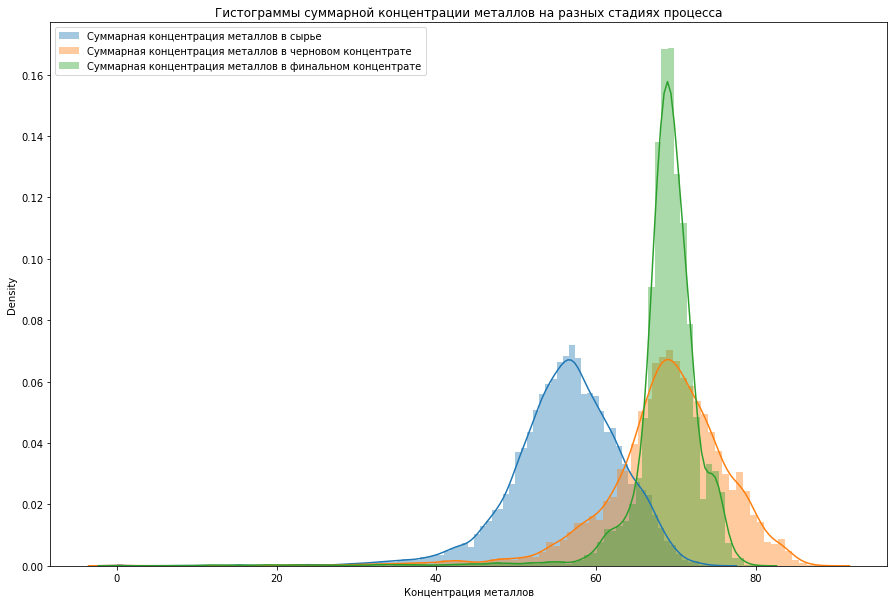

In [18]:
# Перерассчитаем суммарную концентрацию веществ для разных этапов
df_train['sum.rougher.input.feed'] = df_train['rougher.input.feed_pb'] + df_train['rougher.input.feed_ag'] + df_train['rougher.input.feed_sol'] + df_train['rougher.input.feed_au']
df_train['sum.rougher.output.concetrate'] = df_train['rougher.output.concentrate_pb'] + df_train['rougher.output.concentrate_ag'] + df_train['rougher.output.concentrate_sol'] + df_train['rougher.output.concentrate_au']
df_train['sum.final.output.concetrate'] = df_train['final.output.concentrate_pb'] + df_train['final.output.concentrate_ag']+ df_train['final.output.concentrate_sol'] + df_train['final.output.concentrate_au']

# Построим гистрограммы суммарной концентраци металлов на разных стадиях процесса
fig = plt.figure(figsize=(15,10))
lst1 = df_train['sum.rougher.input.feed']
lst2 = df_train['sum.rougher.output.concetrate']
lst3 = df_train['sum.final.output.concetrate']
ax1 = sns.distplot(lst1, label='Суммарная концентрация металлов в сырье', bins = 100)
ax2 = sns.distplot(lst2, label='Суммарная концентрация металлов в черновом концентрате', bins = 100)
ax3 = sns.distplot(lst3, label='Суммарная концентрация металлов в финальном концентрате', bins = 100)
ax4 = plt.legend()
ax5 = plt.title('Гистограммы суммарной концентрации металлов на разных стадиях процесса')
ax6 = plt.xlabel('Концентрация металлов')
plt.show()   

# Удалим колонки с суммарными значениями
df_train.drop(['sum.rougher.input.feed', 'sum.rougher.output.concetrate', 'sum.final.output.concetrate'], axis='columns', inplace=True)

In [19]:
# Проведем аналогичную процедуру очистки данных для полного набора данных
df_full = df_full.dropna(subset=['rougher.output.recovery', 'final.output.recovery'])

# Посчитаем суммарную концентрацию веществ для разных этапов
df_full['sum.rougher.input.feed'] = df_full['rougher.input.feed_pb'] + df_full['rougher.input.feed_ag'] + df_full['rougher.input.feed_sol'] + df_full['rougher.input.feed_au']
df_full['sum.rougher.output.concetrate'] = df_full['rougher.output.concentrate_pb'] + df_full['rougher.output.concentrate_ag'] + df_full['rougher.output.concentrate_sol'] + df_full['rougher.output.concentrate_au']
df_full['sum.final.output.concetrate'] = df_full['final.output.concentrate_pb'] + df_full['final.output.concentrate_ag']+ df_full['final.output.concentrate_sol'] + df_full['final.output.concentrate_au']

# Построим гистрограммы для показателей количество минут
df_full = df_full.drop(df_full[df_full['sum.rougher.input.feed'] == 0].index)
df_full = df_full.drop(df_full[df_full['sum.rougher.output.concetrate'] == 0].index)
df_full = df_full.drop(df_full[df_full['sum.final.output.concetrate'] == 0].index)

# Удалим колонки с суммарными значениями
df_full.drop(['sum.rougher.input.feed', 'sum.rougher.output.concetrate', 'sum.final.output.concetrate'], axis='columns', inplace=True)

#### Проверка расчёта коэффициента извлечения золота

In [20]:
#Создадим копию полного датасета для удаления строк с пропусками
df_full_copy = df_full.copy()
print(df_full_copy.shape)
df_full_copy = df_full_copy.dropna(axis='index', how='any')
print(df_full_copy.shape)

# Создадим переменные для рачёта recovery для чернового концентрата
F = df_full_copy['rougher.input.feed_au']
C = df_full_copy['rougher.output.concentrate_au']
T = df_full_copy['rougher.output.tail_au']

# Создадим колонку recovery и поместим в неё результаты вычислений
df_full_copy['recovery_rougher'] = ((C * (F - T)) / (F * (C - T))) * 100

# Посчитаем минальную аболютную ошибку(mae)
df_full_copy['recovery_rougher'] = df_full_copy['recovery_rougher']
mae_rougher = mean_absolute_error(df_full_copy['recovery_rougher'], df_full_copy['rougher.output.recovery'])
print('Средняя абсолютная ошибка : ',mae_rougher)

# Проверим основные статистики распределений целевых признаков
df_full_copy['recovery_rougher'].describe()
df_full_copy['final.output.recovery'].describe()

(18949, 87)
(15753, 87)
Средняя абсолютная ошибка :  1.0084289709307751e-14


count    15753.000000
mean        85.154552
std          6.953769
min          2.520854
25%         81.614136
50%         86.264526
75%         89.774258
max        100.000000
Name: recovery_rougher, dtype: float64

count    15753.000000
mean        67.762758
std          7.824831
min          2.030917
25%         63.958206
50%         68.365452
75%         72.662848
max        100.000000
Name: final.output.recovery, dtype: float64

**Вывод**

- Заменили пропуски в датасетах df_train и df_test методом interpolate.  
- Удалили записи с аномальными значениями.  
- Посчитали среднюю аболютную ошибку(mae) и проверили статистики распределений целевых признаков на копии полного набора данных, предварительно удалив пропуски.

Значение средней абсолютной ошибки достаточно мало, можно считать, что recovery посчитан верно.

### Разбиение данных на выборки и моделирование

In [21]:
# Отберем из набора данных train только те колонки, которые есть в наборе данных test
X_train = df_train[df_test.columns]


# По получиившемуся набору колонок сформируем наборы данных для моделей флотации и очистки
r_cols = X_train.columns.str.contains('rougher')
r_cols[0] = True
y_train_r = df_train['rougher.output.recovery']
X_train_r = X_train.loc[:, r_cols]
X_test_r = df_test.loc[:, r_cols]
X_test_r = X_test_r.set_index('date')
df_full = df_full.set_index('date')
y_test_r = df_full.loc[X_test_r.index, 'rougher.output.recovery']
X_test_r = X_test_r.reset_index()

c_cols = X_train.columns.str.contains('cleaner')
c_cols[0] = True
y_train_c = df_train['final.output.recovery']
X_train_c = X_train.loc[:, c_cols]
X_test_c = df_test.loc[:, c_cols]
X_test_c = X_test_c.set_index('date')
y_test_c = df_full.loc[X_test_c.index, 'final.output.recovery']
X_test_c = X_test_c.reset_index()

df_full = df_full.reset_index()

X_test_r.drop(['date'], axis='columns', inplace=True)
X_test_c.drop(['date'], axis='columns', inplace=True)
X_train_r.drop(['date'], axis='columns', inplace=True)
X_train_c.drop(['date'], axis='columns', inplace=True)

In [22]:
# Проверим размеры получившихся наборов данных
y_train_r.shape
y_test_r.shape
X_train_r.shape
X_test_r.shape

(13795,)

(5856,)

(13795, 22)

(5856, 22)

In [23]:
# Проверим размеры получившихся наборов данных
y_train_c.shape
y_test_c.shape
X_train_c.shape
X_test_c.shape

(13795,)

(5856,)

(13795, 30)

(5856, 30)

In [24]:
# Стандартизируем признаки методом StandardScaler
numeric_r = X_train_r.columns.to_list()
scaler_r = StandardScaler()
scaler_r.fit(X_train_r[numeric_r])
X_train_r[numeric_r] = scaler_r.transform(X_train_r[numeric_r])
X_test_r[numeric_r] = scaler_r.transform(X_test_r[numeric_r])

numeric_c = X_train_c.columns.to_list()
scaler_c = StandardScaler()
scaler_c.fit(X_train_c[numeric_c])
X_train_c[numeric_c] = scaler_c.transform(X_train_c[numeric_c])
X_test_c[numeric_c] = scaler_c.transform(X_test_c[numeric_c])

StandardScaler(copy=True, with_mean=True, with_std=True)

StandardScaler(copy=True, with_mean=True, with_std=True)

In [25]:
# Осуществим вызов функции start_model для запуска базовых моделей:
# LinearRegression, CatBoostRegressor, Ridge, Lasso
# и рассчитаем метрики для этапов флотации и очистки
model_list = [[CatBoostRegressor(random_state=12345, verbose=0), 'CatBoostRegressor'],
              [LinearRegression(), 'LinearRegression'],
              [Ridge(random_state=12345), 'Ridge'], 
              [Lasso(random_state=12345), 'Lasso']]

smape_rougher = start_model(X_train_r, y_train_r, model_list, 'Запуск моделей для этапа флотации')
smape_cleaner = start_model(X_train_c, y_train_c, model_list, 'Запуск моделей для этапа очистки')

Запуск моделей для этапа флотации
                      smape  time_model
model                                  
CatBoostRegressor  6.787503      145.83
Lasso              6.622127        0.67
LinearRegression   6.490791        0.07
Ridge              6.488470        0.03
---------------------------------
Запуск моделей для этапа очистки
                       smape  time_model
model                                   
CatBoostRegressor  11.744300      180.04
Lasso               9.684728        0.23
LinearRegression    9.900438        0.08
Ridge               9.899154        0.03
---------------------------------


In [26]:
# Расчитаем значение финальной метрики с помощью вызова функции final_smape
result = final_smape(smape_rougher, smape_cleaner)
print('Финальная метрика train/val : ', round(result,2))

Финальная метрика train/val :  8.89


In [27]:
# Посчитаем метрики
smape_test_r = grid_search(X_train_r, y_train_r, X_test_r, y_test_r, 'Запуск GridSearchCV для этапа флотации')
smape_test_c = grid_search(X_train_c, y_train_c, X_test_c, y_test_c, 'Запуск GridSearchCV для этапа очистки')

result = final_smape(smape_test_r, smape_test_c)
print('Финальная метрика на тестовом наборе: ', round(result,2))

Запуск GridSearchCV для этапа флотации
sMAPE модели с наилучшими значениями гиперпараметров на тестовой выборке: 3.87
----------------------------------------
Запуск GridSearchCV для этапа очистки
sMAPE модели с наилучшими значениями гиперпараметров на тестовой выборке: 7.16
----------------------------------------
Финальная метрика на тестовом наборе:  6.34


In [28]:
# Проверим, лучше ли наша модель константного прогноза.
const_pred = pd.DataFrame({'const_r': np.ones(len(X_test_r)) * y_train_r.mean(), 
                           'const_c': np.ones(len(X_test_c)) * y_train_c.mean()})

smape_test_const_r = smape(y_test_r.reset_index(drop=True), const_pred['const_r'].reset_index(drop=True))
smape_test_const_c = smape(y_test_c.reset_index(drop=True), const_pred['const_c'].reset_index(drop=True))

result = final_smape(smape_test_const_r, smape_test_const_c)
print('Финальная метрика на константном наборе: ', round(result,2))

Финальная метрика на константном наборе:  6.84


### Общий вывод

- реализовано разбиение набора данных df_full на train/test с учетом временной структуры
- произведена нормализация данных
- реализован запуск моделей LinearRegression, CatBoostRegressor, Ridge, Lasso
- проведена перекрестная проверка на 5 фолдов 
- произведен расчет метрик smape для этапов флотации и очистки, а так же финальной метрики итоговое sMAPE 
- произведена проверка модели на адекватность - сравнение с константной моделью

Лучший результат показала модель Ridge.   
Значение итоговой метрики sMAPE составило 6.34 (Это означает, что в среднем наше предсказание отклоняется от реального значения менее чем на 6.4%), при этом константная модель продемонстрировала значение итоговой метрики sMAPE равное 6.84.
Разница не очень большая, но для промышленных предприятий такой результат в денежном выражении может дать большой экономический прирост.  